In [21]:
import scanpy as sc, pandas as pd, matplotlib.pyplot as plt, seaborn as sns

## All

In [40]:
%%time
# adata = sc.read_h5ad("Kidney_Combined_hvg5k.h5ad")
adata = sc.read_h5ad("Kidney_Combined_hvg5k_LabeledSubset.h5ad")
adata

CPU times: user 10.8 s, sys: 520 ms, total: 11.3 s
Wall time: 11.4 s


AnnData object with n_obs × n_vars = 411838 × 4960
    obs: 'batch', 'harmonized_celltype', 'donor', 'Sample', 'nCount_RNA', 'nFeature_RNA', 'Cell_type', 'Subcategory', 'barcode', 'celltype', 'donor_id', 'sample_uuid', 'library_uuid', 'cell_type_ontology_term_id', 'author_cell_type', 'doublet_id', 'cell_type', 'assay', 'sex', 'tissue', 'development_stage', 'Patient', 'cancer', 'CD45', 'Stage annotations', 'Grade annotations', 'file integrity', 'orig.ident', 'seurat_clusters', 'patient', 'gene_clustering', 'l', 'original_seurat_clusters', 'CN_Column', 'anno', 'cluster', 'doublet_score', 'gene_per_1kUMI', 'label', 'no_genes', 'no_genes_log10', 'pct_MT', 'sample', 'total_UMI', 'Project_ID', 'percent.mt', 'percent.ribo', 'integrated_snn_res.0.2', 'SNV_GT', 'stim', 'ident', 'Suffix', 'type', 'region', 'Sample2', 'cluster_name', 'UMAP1', 'UMAP2', 'Sample_name', 'n_genes', '_scvi_batch', '_scvi_labels', 'conditions_combined', 'modality'
    var: 'n_counts', 'highly_variable', 'highly_variable

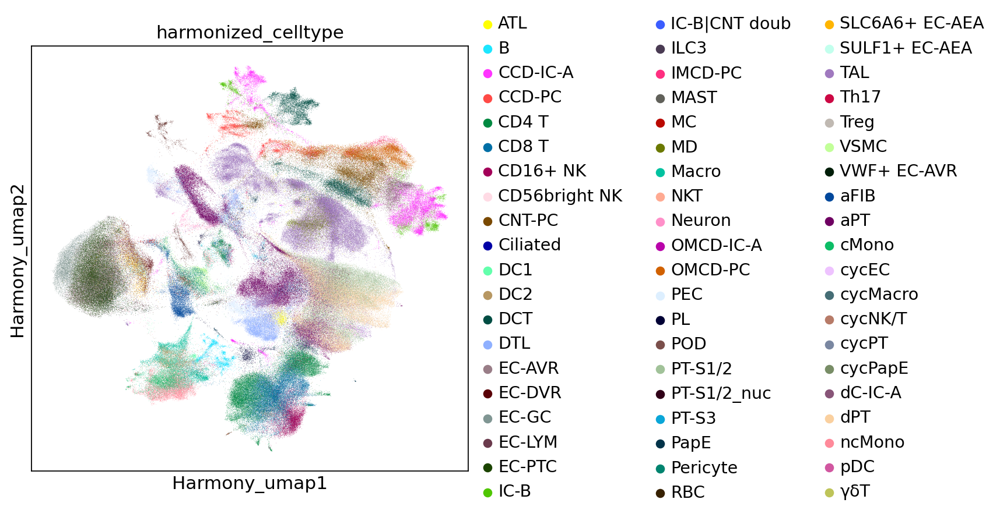

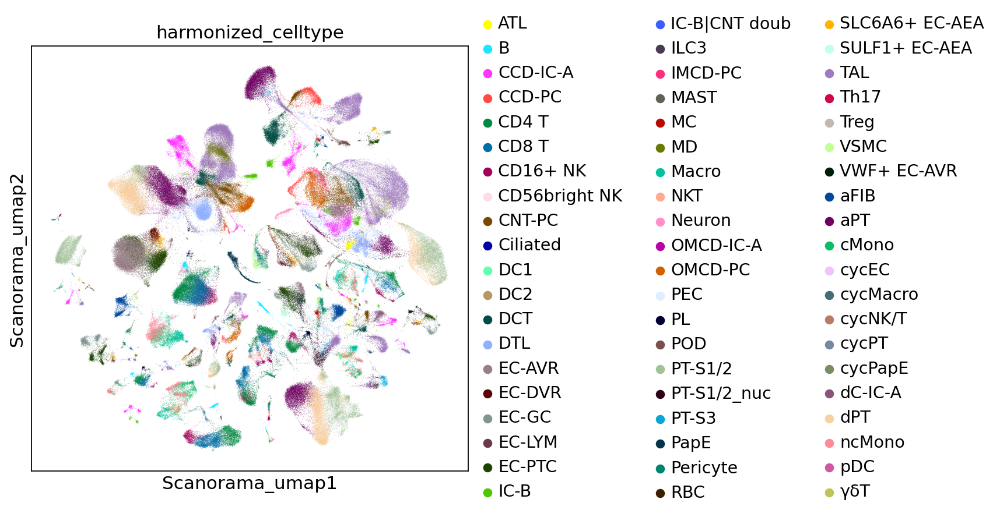

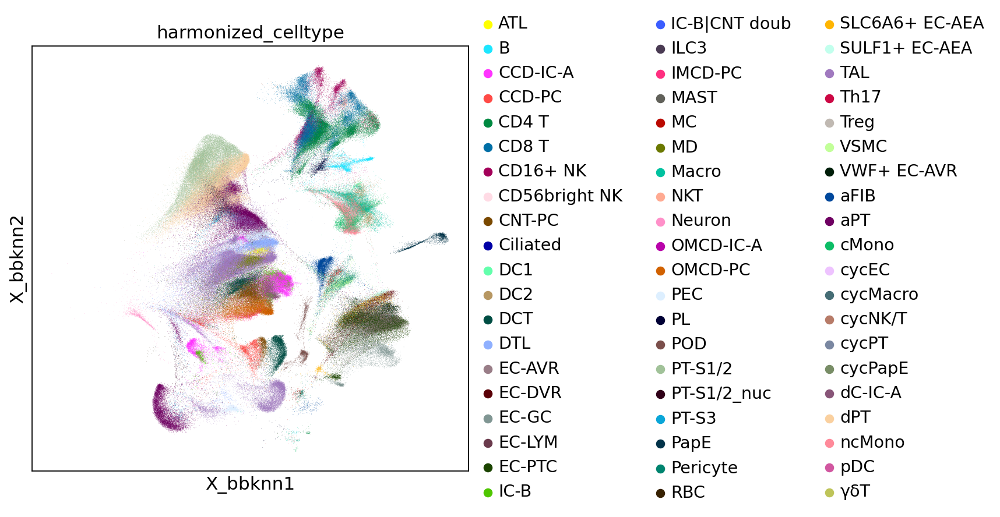

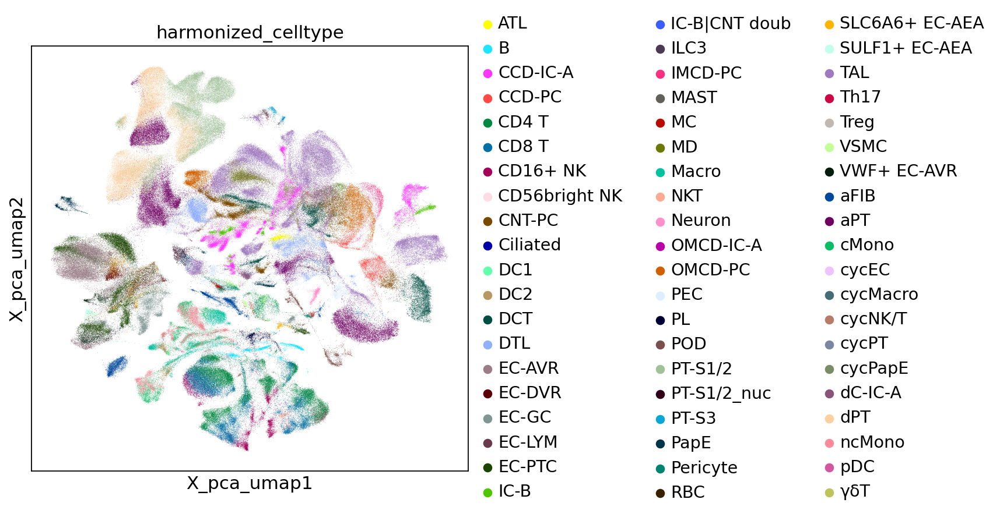

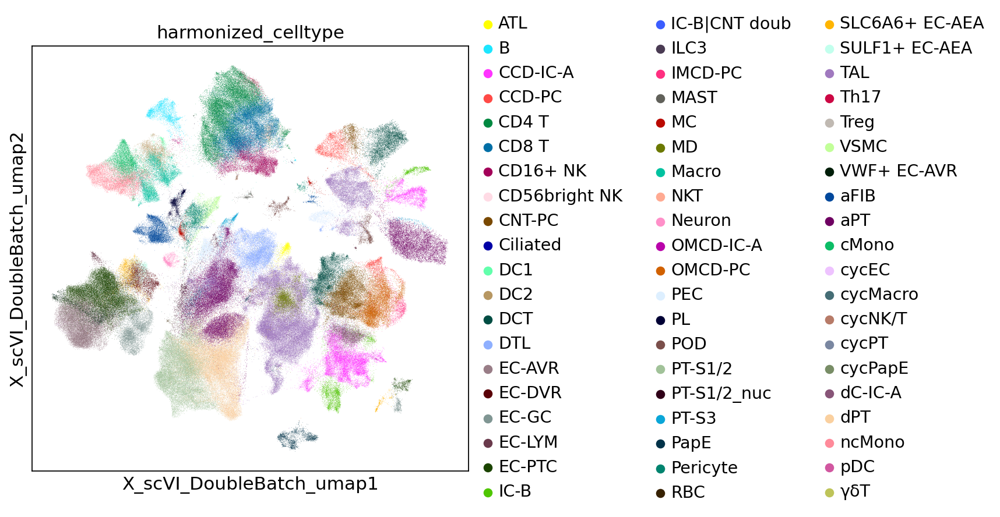

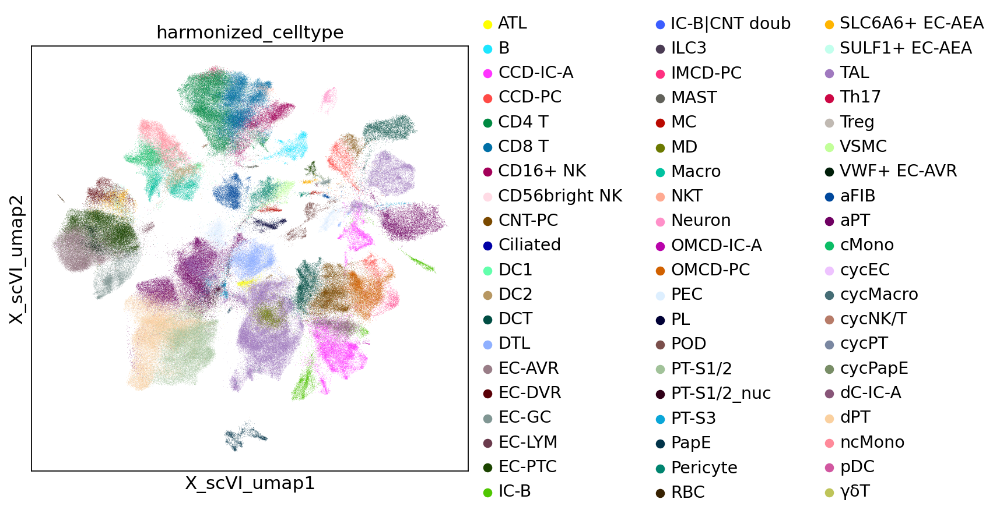

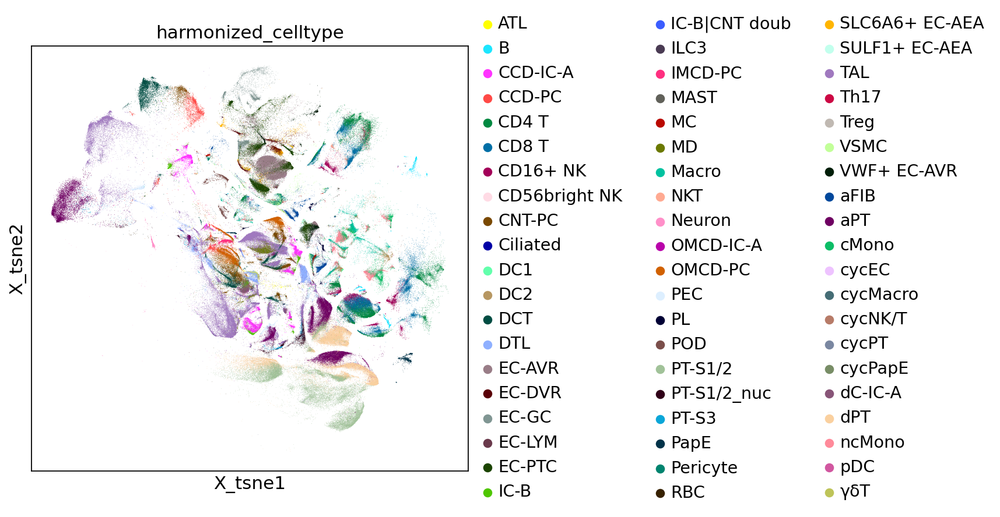

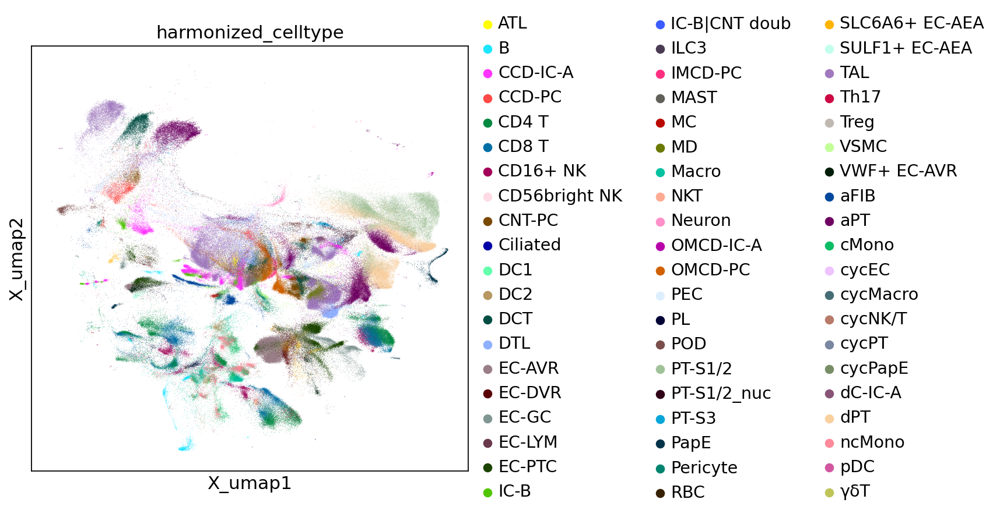

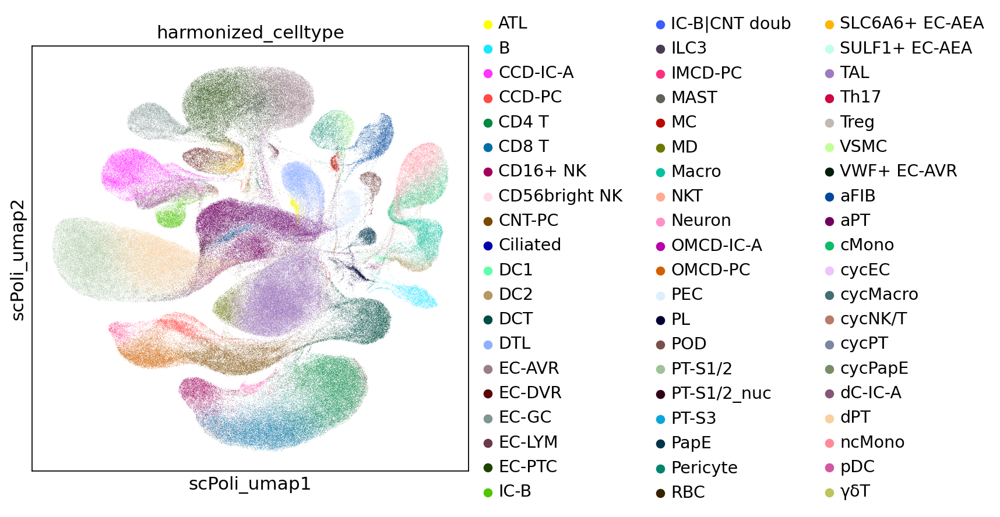

In [41]:
obsm_list = list(adata.obsm.keys()).copy()
sc.set_figure_params(figsize=(6, 6)) 

for _obsm in obsm_list:
    if adata.obsm[_obsm].shape[1] > 2:
        continue
    sc.pl.embedding(adata, _obsm, color="harmonized_celltype")

In [ ]:
obsm_list = list(adata.obsm.keys()).copy()
sc.set_figure_params(figsize=(6, 6)) 

for _obsm in obsm_list:
    if adata.obsm[_obsm].shape[1] > 2:
        continue
    sc.pl.embedding(adata, _obsm, color="modality")

## sc

In [36]:
%%time
# adata = sc.read_h5ad("Kidney_Combined_sc_hvg5k.h5ad")
adata = sc.read_h5ad("Kidney_Combined_sc_hvg5k_LabeledSubset.h5ad")
adata

CPU times: user 9.18 s, sys: 494 ms, total: 9.67 s
Wall time: 9.72 s


AnnData object with n_obs × n_vars = 370373 × 4960
    obs: 'batch', 'harmonized_celltype', 'donor', 'Sample', 'nCount_RNA', 'nFeature_RNA', 'Cell_type', 'Subcategory', 'barcode', 'celltype', 'donor_id', 'sample_uuid', 'library_uuid', 'cell_type_ontology_term_id', 'author_cell_type', 'doublet_id', 'cell_type', 'assay', 'sex', 'tissue', 'development_stage', 'Patient', 'cancer', 'CD45', 'Stage annotations', 'Grade annotations', 'file integrity', 'orig.ident', 'seurat_clusters', 'patient', 'gene_clustering', 'l', 'original_seurat_clusters', 'CN_Column', 'anno', 'cluster', 'doublet_score', 'gene_per_1kUMI', 'label', 'no_genes', 'no_genes_log10', 'pct_MT', 'sample', 'total_UMI', 'Project_ID', 'percent.mt', 'percent.ribo', 'integrated_snn_res.0.2', 'SNV_GT', 'stim', 'ident', 'Suffix', 'type', 'region', 'Sample2', 'cluster_name', 'UMAP1', 'UMAP2', 'Sample_name', 'n_genes', 'modality', '_scvi_batch', '_scvi_labels', 'conditions_combined'
    var: 'n_counts', 'highly_variable', 'highly_variable

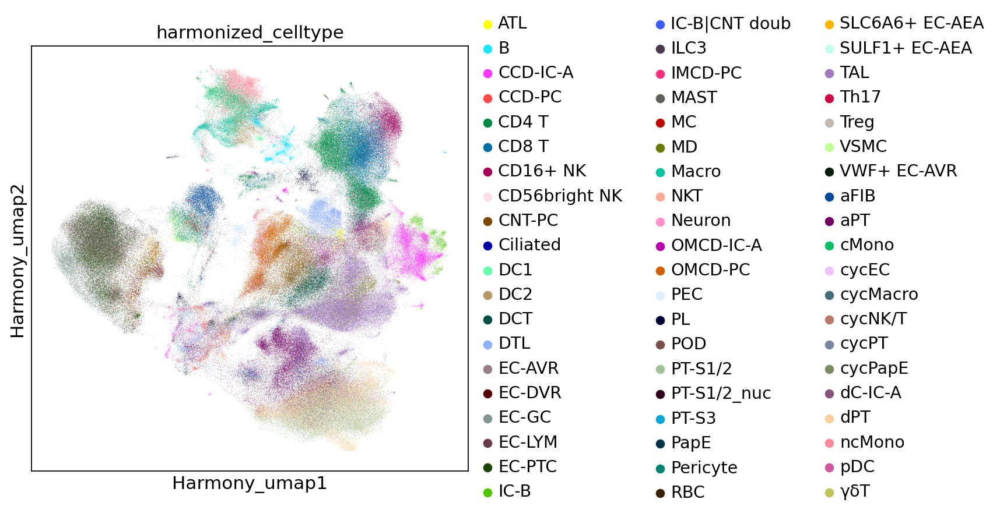

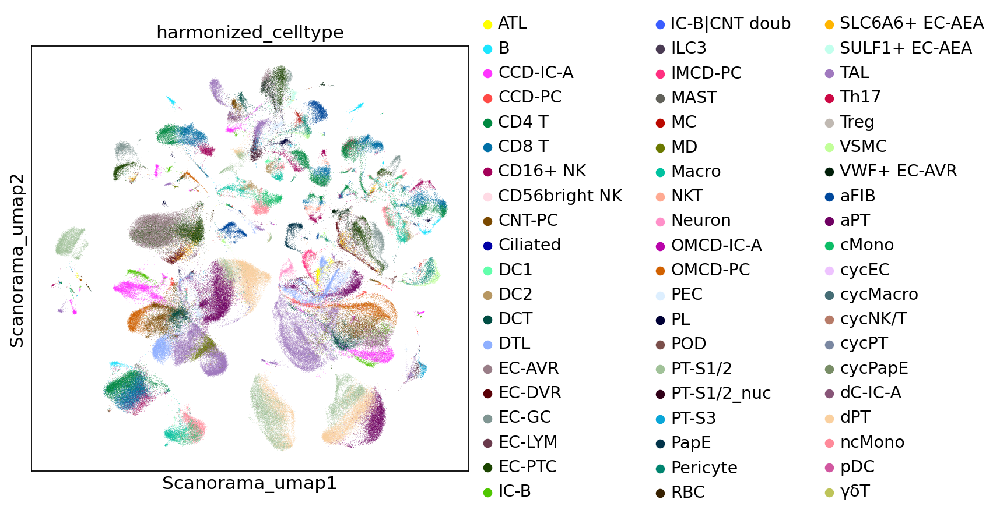

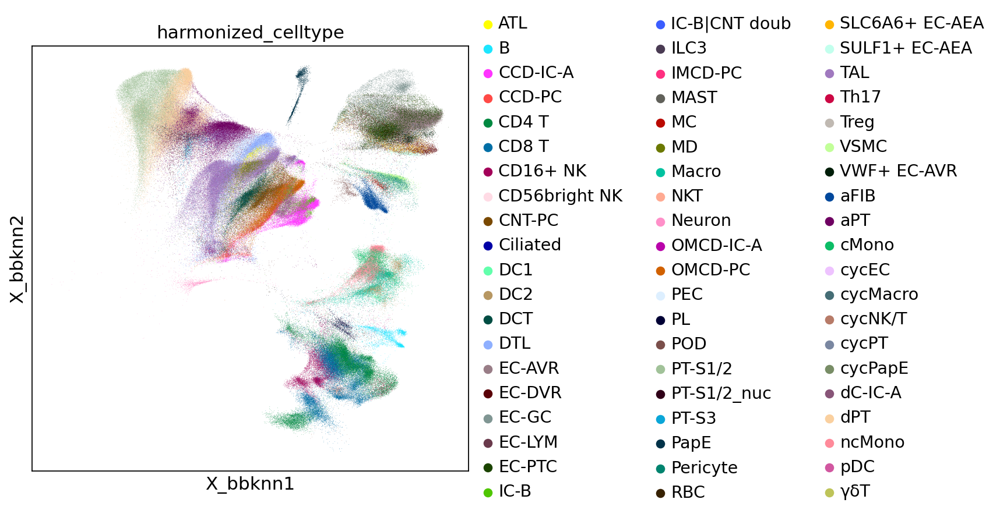

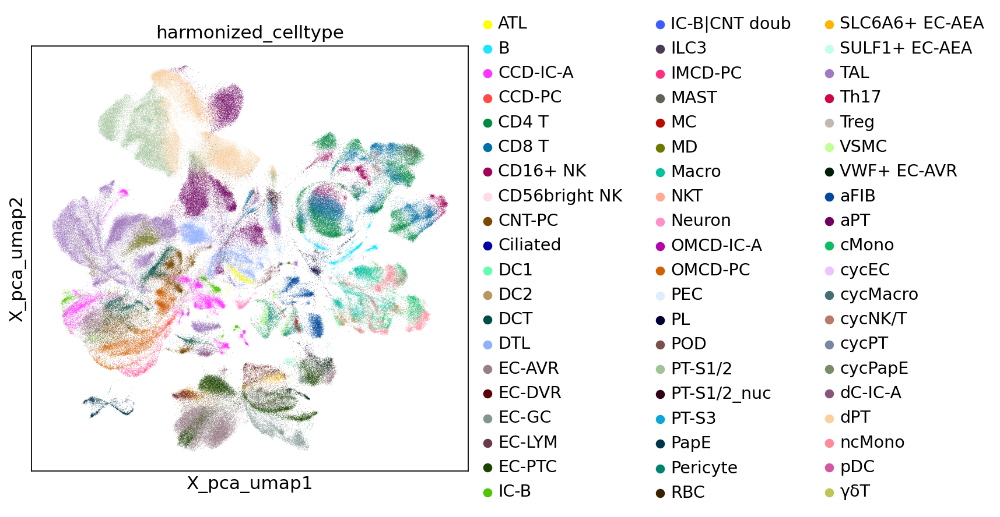

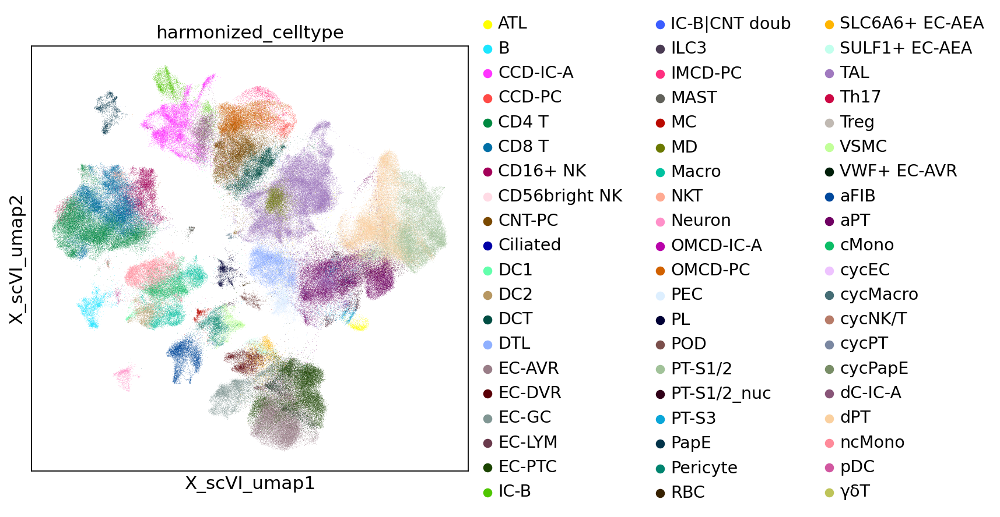

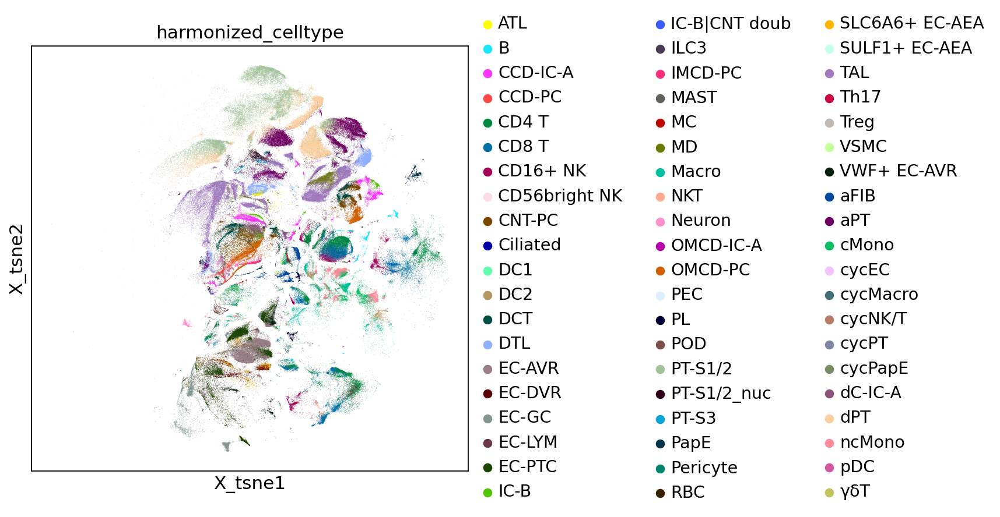

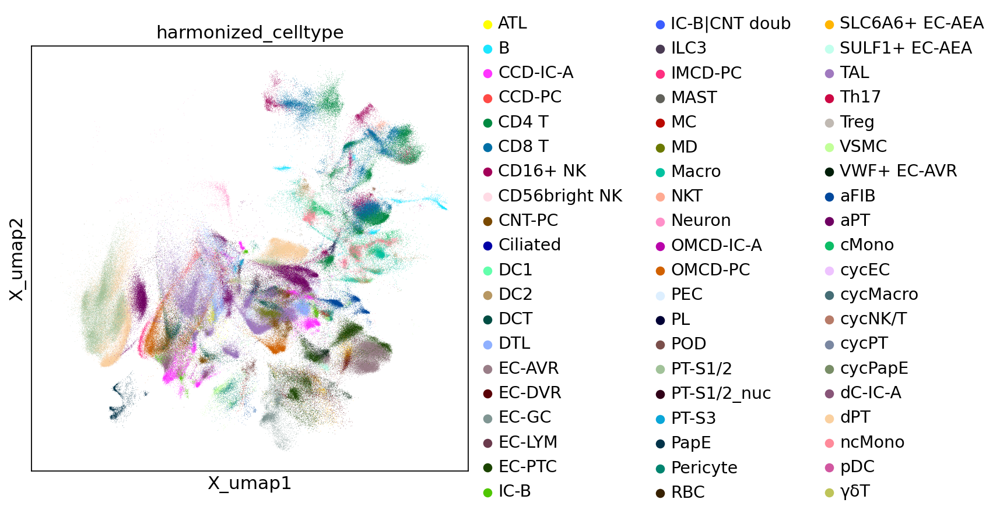

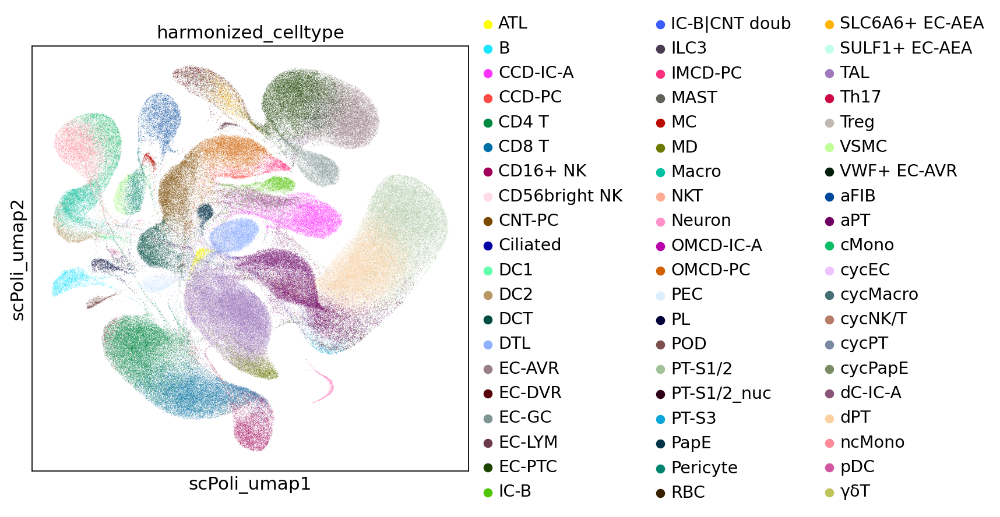

In [37]:
obsm_list = list(adata.obsm.keys()).copy()
sc.set_figure_params(figsize=(6, 6)) 

for _obsm in obsm_list:
    if adata.obsm[_obsm].shape[1] > 2:
        continue
    sc.pl.embedding(adata, _obsm, color="harmonized_celltype")

In [38]:
perf = pd.read_csv("scIB/kidney_hvg5k_sc.csv")
perf_to_plot = perf.iloc[:-1, -3:].astype(float)
perf_to_plot.index = perf.Embedding[:-1]
perf_to_plot

,Batch correction,Bio conservation,Total
Embedding,,,
Harmony,0.564590,0.520098,0.537895
Scanorama,0.346516,0.526811,0.454693
X_bbknn,0.271701,0.519378,0.420307
X_pca,0.398447,0.552052,0.490610
X_scVI,0.480110,0.622512,0.565551
X_tsne,0.252343,0.487392,0.393372
X_umap,0.258787,0.486615,0.395484
scPoli,0.487684,0.703747,0.617322


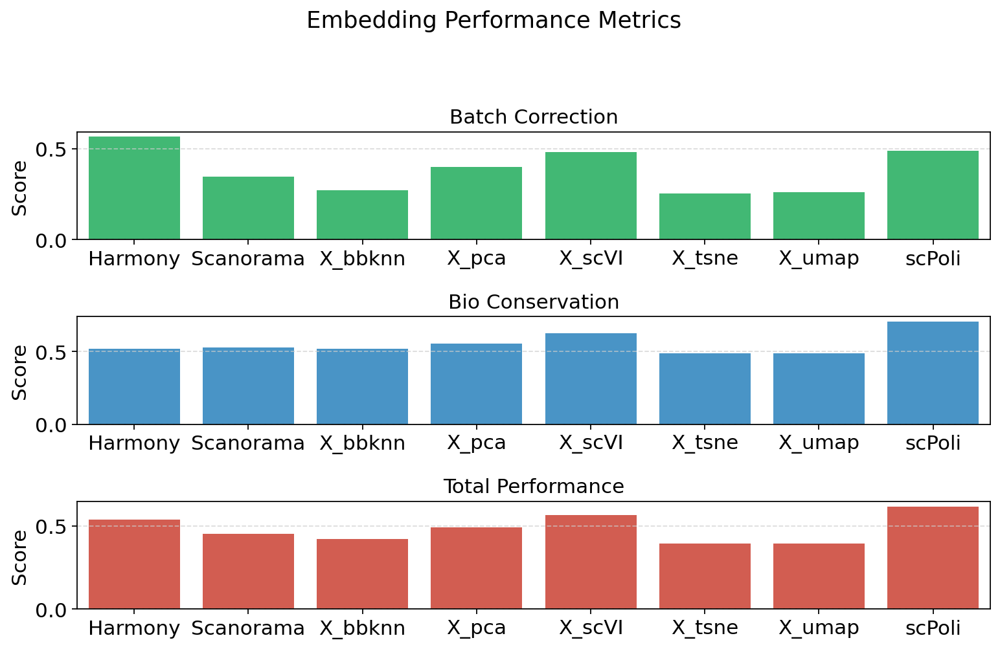

In [42]:
# Create figure and subplots
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(10, 6))
fig.suptitle('Embedding Performance Metrics', fontsize=16, y=1.05)

colors = ['#2ecc71', '#3498db', '#e74c3c']

sns.barplot(x='Embedding', y='Batch correction', data=perf_to_plot, ax=ax1, color=colors[0])
ax1.set_title('Batch Correction')
# ax1.set_ylim(0.4, 0.9)

sns.barplot(x='Embedding', y='Bio conservation', data=perf_to_plot, ax=ax2, color=colors[1])
ax2.set_title('Bio Conservation')
# ax2.set_ylim(0.4, 0.9)

sns.barplot(x='Embedding', y='Total', data=perf_to_plot, ax=ax3, color=colors[2])
ax3.set_title('Total Performance')
# ax3.set_ylim(0.4, 0.9)

for ax in [ax1, ax2, ax3]:
    ax.grid(True, axis='y', linestyle='--', alpha=0.7)
    ax.set_xlabel('')
    ax.set_ylabel('Score')

plt.tight_layout()
plt.show()

## sn 

In [31]:
# adata = sc.read_h5ad("Kidney_Combined_sn_hvg5k.h5ad")
adata = sc.read_h5ad("Kidney_Combined_sn_hvg5k_LabeledSubset.h5ad")
adata

AnnData object with n_obs × n_vars = 41465 × 4438
    obs: 'batch', 'harmonized_celltype', 'donor', 'Sample', 'nCount_RNA', 'nFeature_RNA', 'Cell_type', 'Subcategory', 'barcode', 'celltype', 'donor_id', 'sample_uuid', 'library_uuid', 'cell_type_ontology_term_id', 'author_cell_type', 'doublet_id', 'cell_type', 'assay', 'sex', 'tissue', 'development_stage', 'Patient', 'cancer', 'CD45', 'Stage annotations', 'Grade annotations', 'file integrity', 'orig.ident', 'seurat_clusters', 'patient', 'gene_clustering', 'l', 'original_seurat_clusters', 'CN_Column', 'anno', 'cluster', 'doublet_score', 'gene_per_1kUMI', 'label', 'no_genes', 'no_genes_log10', 'pct_MT', 'sample', 'total_UMI', 'Project_ID', 'percent.mt', 'percent.ribo', 'integrated_snn_res.0.2', 'SNV_GT', 'stim', 'ident', 'Suffix', 'type', 'region', 'Sample2', 'cluster_name', 'UMAP1', 'UMAP2', 'Sample_name', 'n_genes', 'modality', '_scvi_batch', '_scvi_labels', 'conditions_combined'
    var: 'n_counts', 'highly_variable', 'highly_variable_

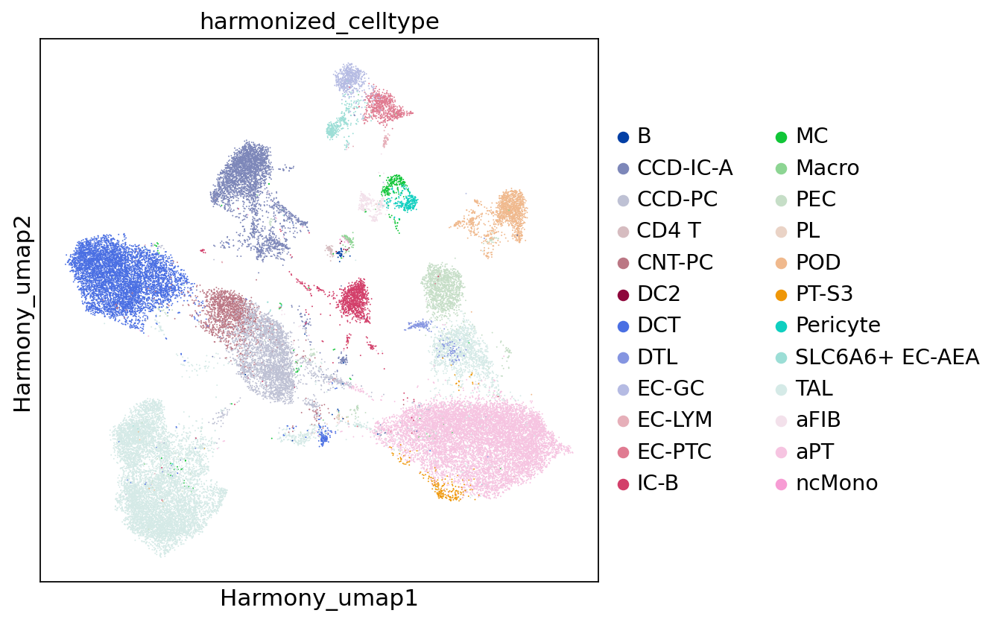

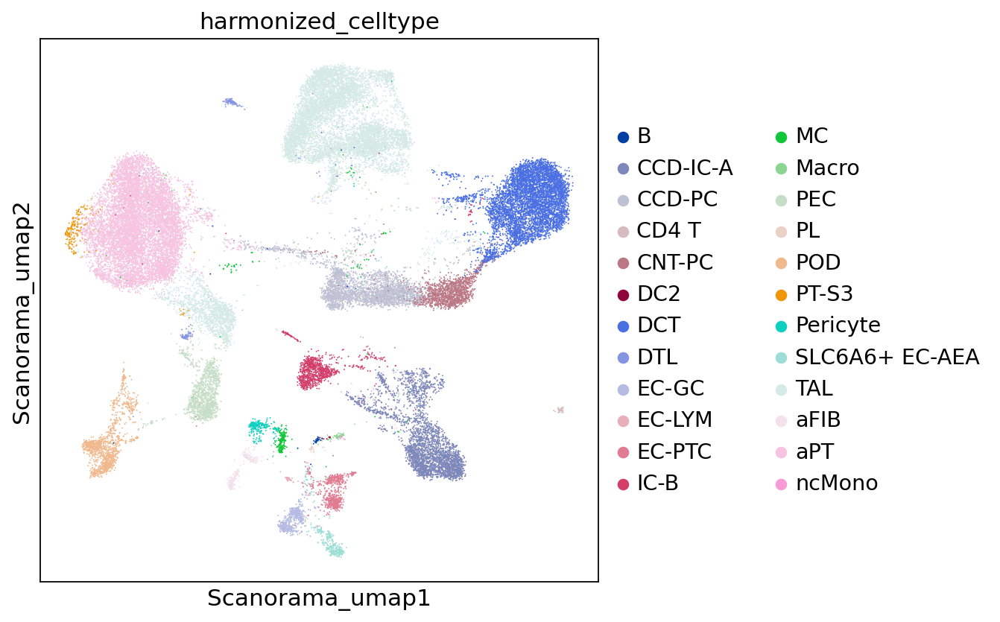

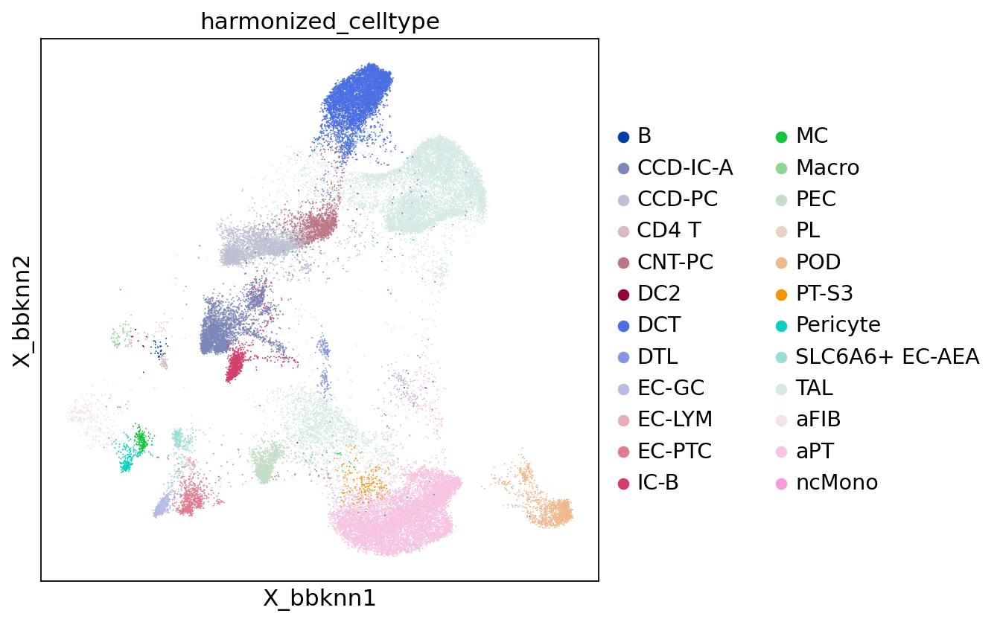

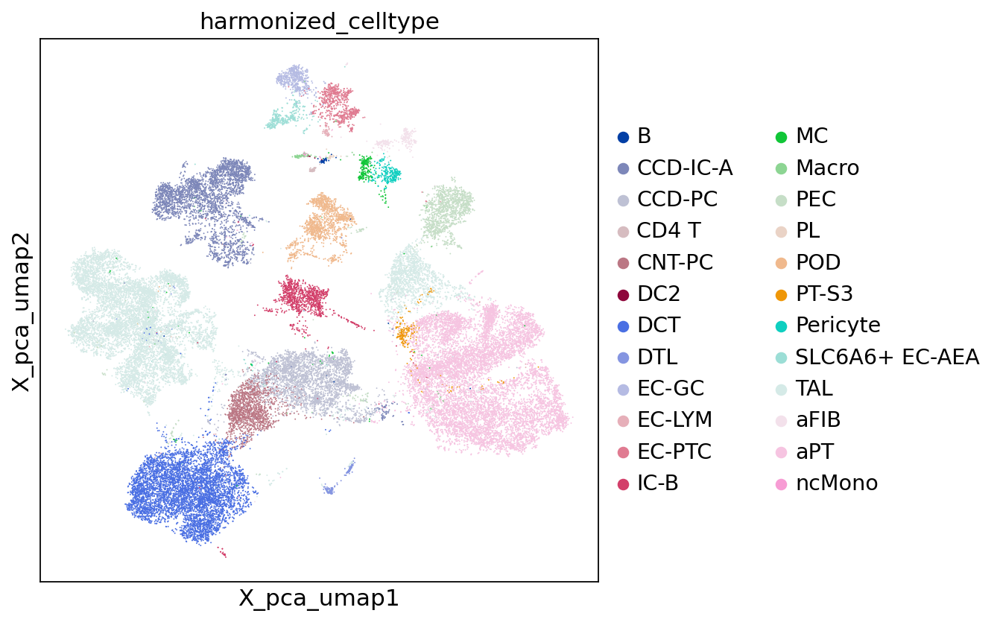

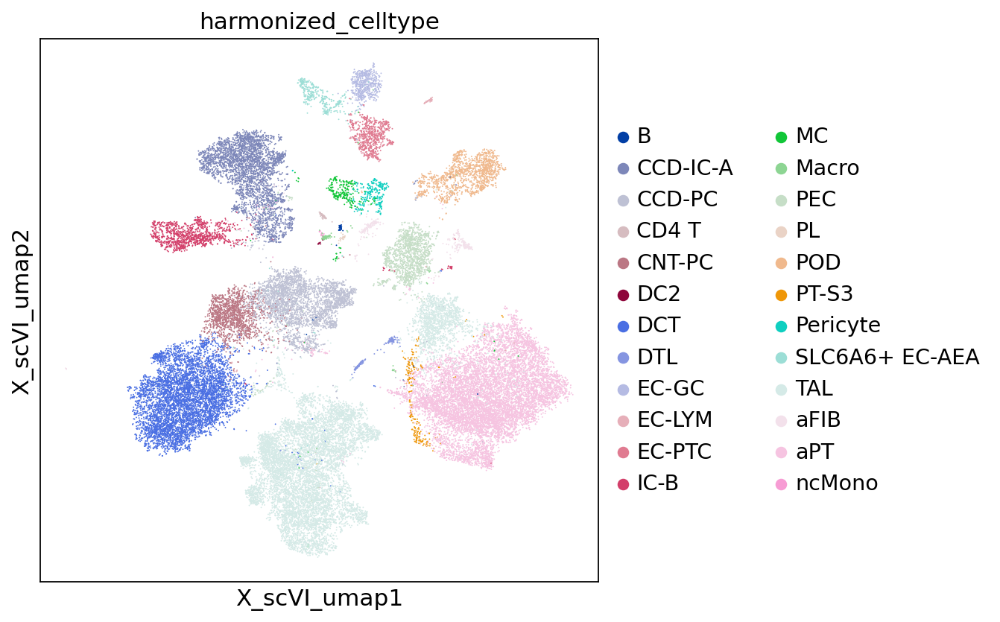

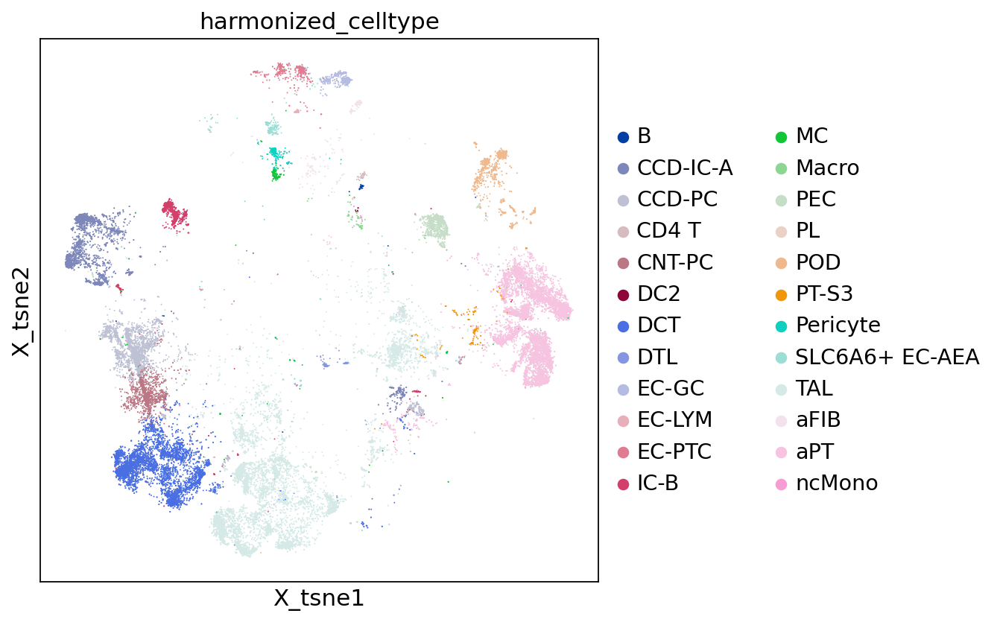

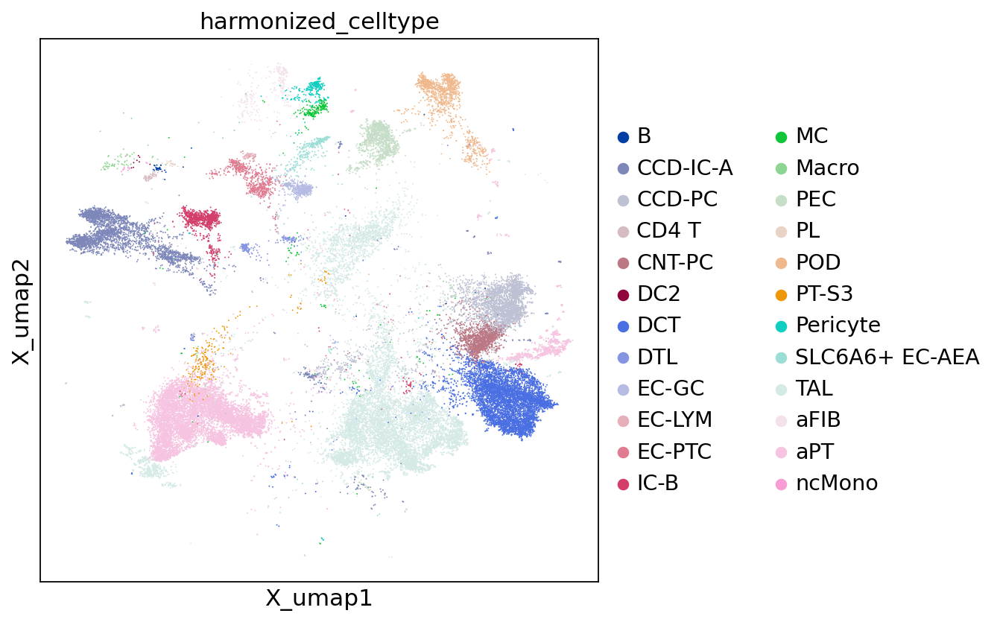

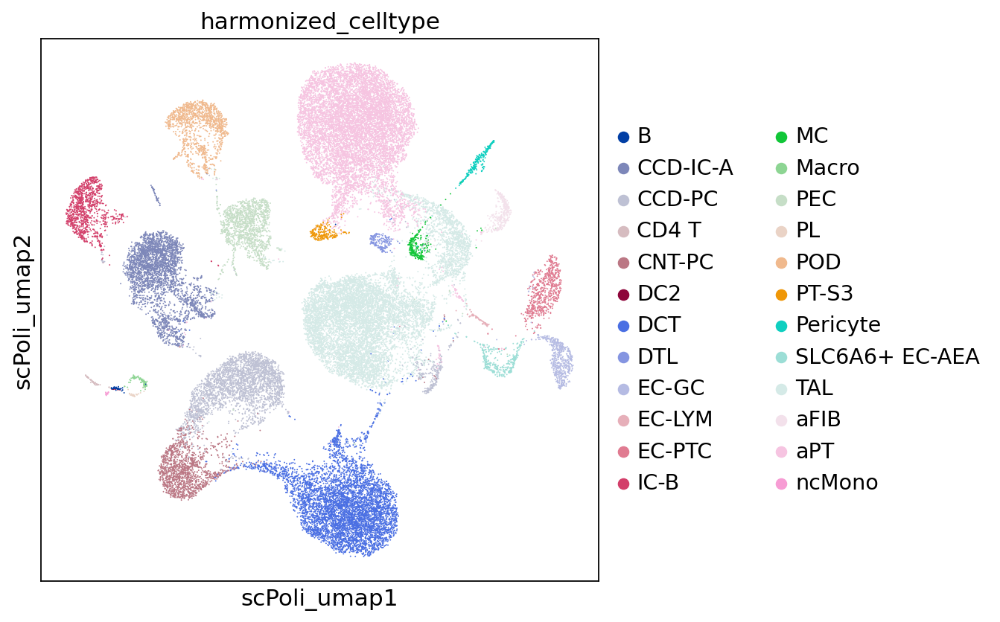

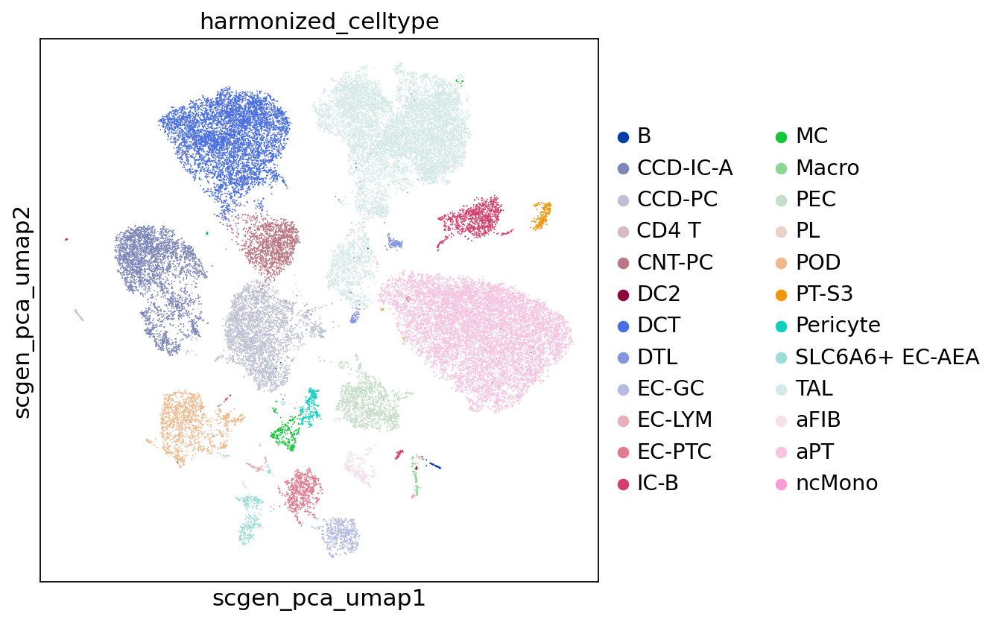

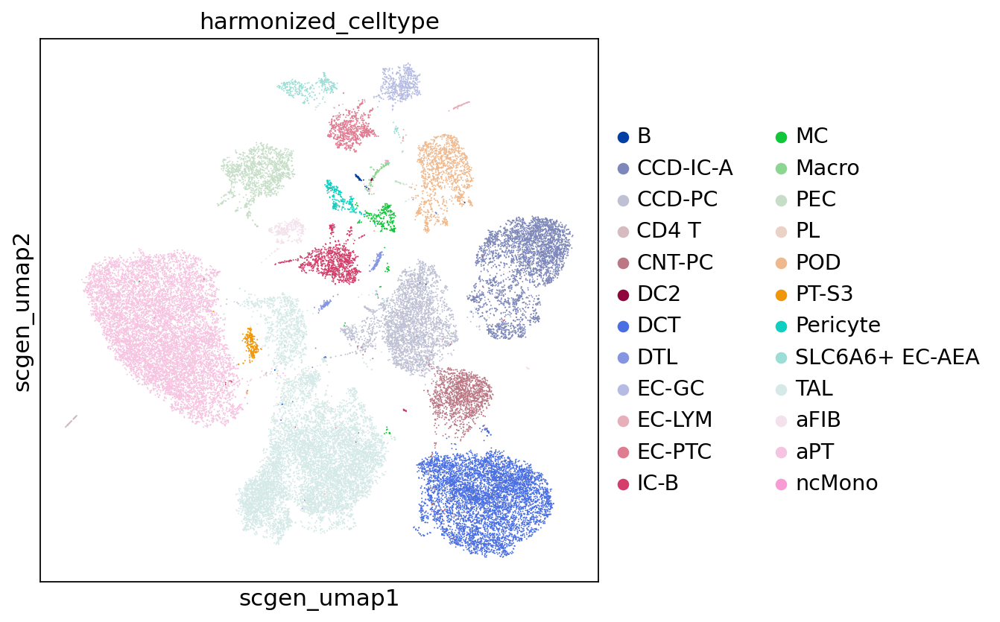

In [34]:
obsm_list = list(adata.obsm.keys()).copy()
sc.set_figure_params(figsize=(6, 6)) 

for _obsm in obsm_list:
    if adata.obsm[_obsm].shape[1] > 2:
        continue
    sc.pl.embedding(adata, _obsm, color="harmonized_celltype")

In [9]:
perf = pd.read_csv("scIB/kidney_hvg5k_sn.csv")
perf_to_plot = perf.iloc[:-1, -3:].astype(float)
perf_to_plot.index = perf.Embedding[:-1]
perf_to_plot

,Embedding,Isolated labels,Leiden NMI,Leiden ARI,KMeans NMI,KMeans ARI,Silhouette label,cLISI,Silhouette batch,iLISI,KBET,Graph connectivity,PCR comparison,Batch correction,Bio conservation,Total
0,Harmony,0.540726,0.82882937260711,0.8377326299904835,0.6908273958407785,0.38477729844632164,0.595244899392128,0.9999999948169874,0.8997956,0.22233684857686362,0.6100074595940128,0.7438646274951074,0.6083137657975501,0.6168636586589482,0.6968767995892636,0.6648715432171375
1,Scanorama,0.5602702,0.8682042890730312,0.8662083257478447,0.7281148924331592,0.4583225005945037,0.6013253852725029,0.9999999948169874,0.90308905,0.16376890738805136,0.43279168025267645,0.6242134232929579,0.2956970601271818,0.4839120235078278,0.7260636540252831,0.629203001818301
2,X_bbknn,0.48560444,0.6906366428084437,0.31102646932705674,0.7145172369982387,0.3954367960843906,0.6385822296142578,0.9999999896339749,0.65791434,0.32133130232493085,0.46689940048664186,0.8464776162367587,0.3199850422314584,0.5225215403551706,0.605114828524546,0.5720775132567959
3,X_pca,0.581348,0.8396411679478996,0.748275208282853,0.714936338835373,0.4089967250459227,0.6261211633682251,0.9999999948169874,0.8952098,0.10153192281723022,0.4204268225946948,0.8252305782552293,0.0,0.44847982258865543,0.7027598000363142,0.6010478090572506
4,X_scVI,0.631876,0.8714534785569162,0.8663037025443309,0.7359740674748492,0.4192255796181516,0.6200899258255959,0.9999999948169874,0.9002635,0.15425493319829306,0.5028118389754326,0.9053213953292887,0.1281153521215759,0.5181534015834569,0.7349889629511601,0.6482547384040789
5,X_tsne,0.55088055,0.6442271497024684,0.18999478161937258,0.7038998537010495,0.3944463881971866,0.6200001388788223,0.9999999948169874,0.6234593,0.12523428599039713,0.27097600337590666,0.7666460712445667,0.3697885117394002,0.4312208303774943,0.5862069797505833,0.5242125200013477
6,X_umap,0.44613057,0.6662547019882106,0.2992843026517967,0.6744841600462333,0.3762196146752249,0.585058756172657,0.9999999896339749,0.6324504,0.2231400410334269,0.3758356145173347,0.8357669962390374,0.26502394017105135,0.466443398748768,0.5782045855596627,0.5335001108353048
7,scgen_pca,0.69128025,0.9392910007934575,0.9238911341011053,0.7765153141558171,0.489114137053409,0.7118496894836426,1.0,0.80008703,0.2479137380917867,0.6769979157035999,0.9032522433013831,0.4226620876417693,0.610182603888168,0.7902773601954823,0.7182394576725566
8,scgen_umap,0.41325498,0.7554954059213551,0.3388319206860139,0.7650251469438505,0.3971519517306951,0.6788743436336517,0.9999999948169874,0.69436234,0.40963470935821533,0.7349781354883566,0.8977884173436702,0.4517934667445952,0.6377114142584945,0.6212333914293052,0.6278246005609809
9,scPoli,0.67293954,0.8944036665250912,0.8708165996632249,0.8205177968212644,0.5938846033511554,0.8169039487838745,1.0,0.7950637,0.25638290246327716,0.7510976331029875,0.897871212609262,0.48991382274092266,0.6380658490732739,0.8099237363000427,0.7411805814093351


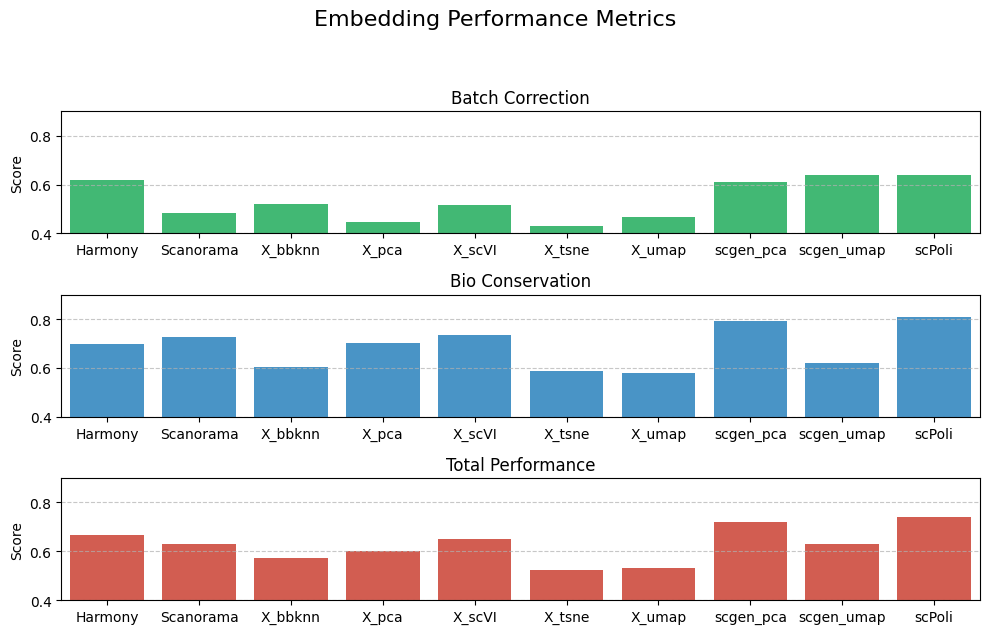

In [29]:
# Create figure and subplots
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(10, 6))
fig.suptitle('Embedding Performance Metrics', fontsize=16, y=1.05)

colors = ['#2ecc71', '#3498db', '#e74c3c']

sns.barplot(x='Embedding', y='Batch correction', data=perf_to_plot, ax=ax1, color=colors[0])
ax1.set_title('Batch Correction')
ax1.set_ylim(0.4, 0.9)

sns.barplot(x='Embedding', y='Bio conservation', data=perf_to_plot, ax=ax2, color=colors[1])
ax2.set_title('Bio Conservation')
ax2.set_ylim(0.4, 0.9)

sns.barplot(x='Embedding', y='Total', data=perf_to_plot, ax=ax3, color=colors[2])
ax3.set_title('Total Performance')
ax3.set_ylim(0.4, 0.9)

for ax in [ax1, ax2, ax3]:
    ax.grid(True, axis='y', linestyle='--', alpha=0.7)
    ax.set_xlabel('')
    ax.set_ylabel('Score')

plt.tight_layout()
plt.show()